<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:200%; font:'Verdana', sans-serif; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>Upvote, please, if you liked this notebook!</b>
</div>

My notebook with G.Boost models for this competition is here:

https://www.kaggle.com/code/rudenkobogdan/ps4e11-eda-lgb-xgb-catb-line-val-0-975

# Table of Content
---
- <a href='#c1'> 1. Import modules, building classes and read CSV </a>

- <a href='#c2'> 2. Exploratory data analysis </a>

- <a href='#c3'> 3. Data Analysis </a>

- <a href='#c4'> 4. Model building</a>

- <a href='#c5'> 5. Validation</a>

- <a href='#c6'> 6. Results and submission</a>
---

<a id='c1'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b>1. Import modules, building classes and read CSV</b></div>

In [1]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns

!pip install -q sweetviz
import sweetviz as sv 

from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder, OrdinalEncoder
from sklearn.model_selection import cross_val_score, KFold
from sklearn.metrics import make_scorer, roc_auc_score
from sklearn.metrics import accuracy_score


import plotly.express as px
import plotly.graph_objects as go

import torch
import torch.nn as nn
import torch.optim as optim

from IPython.display import Image, display
from tqdm import tqdm
import imageio
import os

import warnings
warnings.filterwarnings("ignore")

device = torch.device("cpu")

In [2]:
train = pd.read_csv('/kaggle/input/playground-series-s4e11/train.csv')
test = pd.read_csv('/kaggle/input/playground-series-s4e11/test.csv')
original = pd.read_csv('/kaggle/input/depression-surveydataset-for-analysis/final_depression_dataset_1.csv')

## Plotly Visualizer Class

In [3]:
class PlotlyVisualizer:
    def __init__(self, dataframe):
        self.df = dataframe

    def histogram(self, column, title='Histogram', color='blue', hue=None):
        fig = px.histogram(self.df, x=column, color=hue, title=title)
        fig.update_traces(marker_line_color='black', marker_line_width=1.5, opacity=0.7)
        fig.update_xaxes(title_text=column, title_font=dict(size=14, color='black'), tickangle=45)
        fig.update_yaxes(title_text='Count', title_font=dict(size=14, color='black'))
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def scatter(self, x_column, y_column, title='Scatter Plot', color='blue', hue=None):
        fig = px.scatter(self.df, x=x_column, y=y_column, color=hue, title=title)
        fig.update_traces(marker=dict(size=5, line=dict(width=1, color='black')), opacity=0.7)
        fig.update_xaxes(title_text=x_column, title_font=dict(size=14, color='black'))
        fig.update_yaxes(title_text=y_column, title_font=dict(size=14, color='black'))
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def box_plot(self, column, title='Box Plot', color='blue', hue=None):
        fig = px.box(self.df, y=column, color=hue, title=title)
        fig.update_traces(marker_color=color, boxmean='sd')
        fig.update_yaxes(title_text=column, title_font=dict(size=14, color='black'))
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def line_plot(self, x_column, y_column, title='Line Plot', color='blue', hue=None):
        fig = px.line(self.df, x=x_column, y=y_column, color=hue, title=title)
        fig.update_traces(line=dict(width=2), marker=dict(size=5))
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5,
                          xaxis_title=x_column, yaxis_title=y_column,
                          plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def bar_chart(self, x_column, y_column, title='Bar Chart', color='blue', hue=None):
        fig = px.bar(self.df, x=x_column, y=y_column, color=hue, title=title)
        fig.update_traces(marker_color=color)
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def pie_chart(self, column, title='Pie Chart', hue=None):
        value_counts = self.df[column].value_counts()
        total = value_counts.sum()
        percentages = (value_counts / total) * 100
        
        filtered_value_counts = value_counts[percentages > 1]
        
        other_sum = value_counts[percentages <= 1].sum()
        
        if other_sum > 0:
            filtered_value_counts['Other'] = other_sum

        fig = px.pie(
            values=filtered_value_counts,
            names=filtered_value_counts.index,
            title=title
        )
        
        fig.update_traces(textinfo='label+percent')  
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, 
                          plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def heatmap(self, x_column, y_column, z_column, title='Heatmap'):
        fig = px.density_heatmap(self.df, x=x_column, y=y_column, z=z_column, title=title)
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def area_chart(self, x_column, y_column, title='Area Chart', color='blue', hue=None):
        fig = px.area(self.df, x=x_column, y=y_column, color=hue, title=title)
        fig.update_traces(fillcolor=color)
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def violin_plot(self, column, title='Violin Plot', color='blue', hue=None):
        fig = px.violin(self.df, y=column, color=hue, title=title)
        fig.update_traces(marker_color=color)
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def sunburst_chart(self, path, title='Sunburst Chart'):
        fig = px.sunburst(self.df, path=path, title=title)
        fig.update_layout(title_font=dict(size=20, color='darkblue'), title_x=0.5, plot_bgcolor='lightgray', paper_bgcolor='white')
        fig.show()

    def missmap(self, title='Missing Data Map'):
        missing_data = self.df.isnull().astype(int)
        missing_data_long = missing_data.reset_index().melt(id_vars="index")
        missing_data_long.columns = ["Row", "Column", "Missing"]
        missing_data_pivot = missing_data_long.pivot_table(index="Row", columns="Column", values="Missing", fill_value=0)
        fig = px.imshow(
            missing_data_pivot,
            color_continuous_scale=["#3498db", "#e74c3c"],
            labels={"color": "Missing"},
            title=title
        )
        fig.update_layout(
            title_font=dict(size=20, color='darkblue'), 
            title_x=0.5,
            xaxis_title="Columns", 
            yaxis_title="Rows",
            plot_bgcolor='lightgray', 
            paper_bgcolor='white'
        )
        fig.show()

pv = PlotlyVisualizer(train)

<a id='c2'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b> 2. Exploratory Data Analysis </b></div>

## Dataset Description

This dataset contains information on individuals' mental health, work/study life, and demographics. It includes 140,700 entries with 20 columns, detailing various aspects like academic pressure, job satisfaction, dietary habits, and mental health history.

#### Columns:
1. **id**: Unique identifier for each entry (int).
2. **Name**: Name of the individual (string).
3. **Gender**: Gender of the individual (string).
4. **Age**: Age of the individual (float).
5. **City**: City of residence (string).
6. **Working Professional or Student**: Indicates if the individual is a working professional or student (string).
7. **Profession**: Profession of the individual, where applicable (string, 74% non-null).
8. **Academic Pressure**: Academic pressure level (float, 20% non-null).
9. **Work Pressure**: Work pressure level (float, 80% non-null).
10. **CGPA**: Current Grade Point Average for students (float, 20% non-null).
11. **Study Satisfaction**: Satisfaction with studies (float, 20% non-null).
12. **Job Satisfaction**: Satisfaction with job (float, 80% non-null).
13. **Sleep Duration**: Duration of sleep (string).
14. **Dietary Habits**: Dietary habits of the individual (string).
15. **Degree**: Degree the individual holds (string).
16. **Have you ever had suicidal thoughts?**: Indicates if the individual has experienced suicidal thoughts (string).
17. **Work/Study Hours**: Number of hours spent working or studying daily (float).
18. **Financial Stress**: Financial stress level (float).
19. **Family History of Mental Illness**: Indicates if there is a family history of mental illness (string).
20. **Depression**: Indicates presence of depression (int).

#### Data Summary:
- **Total Entries**: 140,700
- **Total Columns**: 20
- **Memory Usage**: Approximately 21.5 MB


In [4]:
target = 'Depression'

numerical_columns = [
    "Age", "Academic Pressure", "Work Pressure", "CGPA",
    "Study Satisfaction", "Job Satisfaction", "Work/Study Hours",
    "Financial Stress"
]

one_hot_columns = [
    "Gender", "Working Professional or Student", "City", "Family History of Mental Illness"
]

label_columns = [
    "Degree", "Profession", "Dietary Habits", "Have you ever had suicidal thoughts ?"
]


In [5]:
pv.pie_chart(target)

                                             |          | [  0%]   00:00 -> (? left)


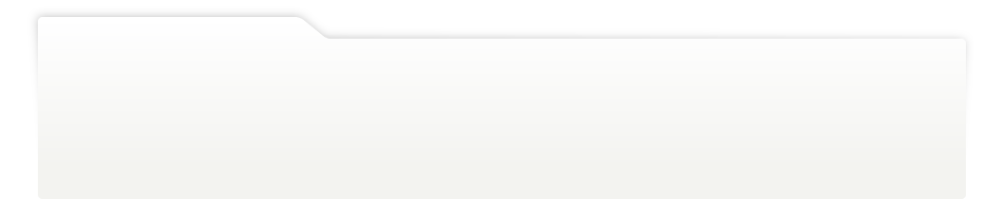
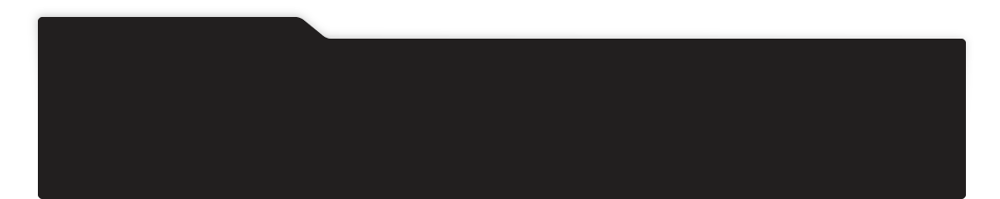
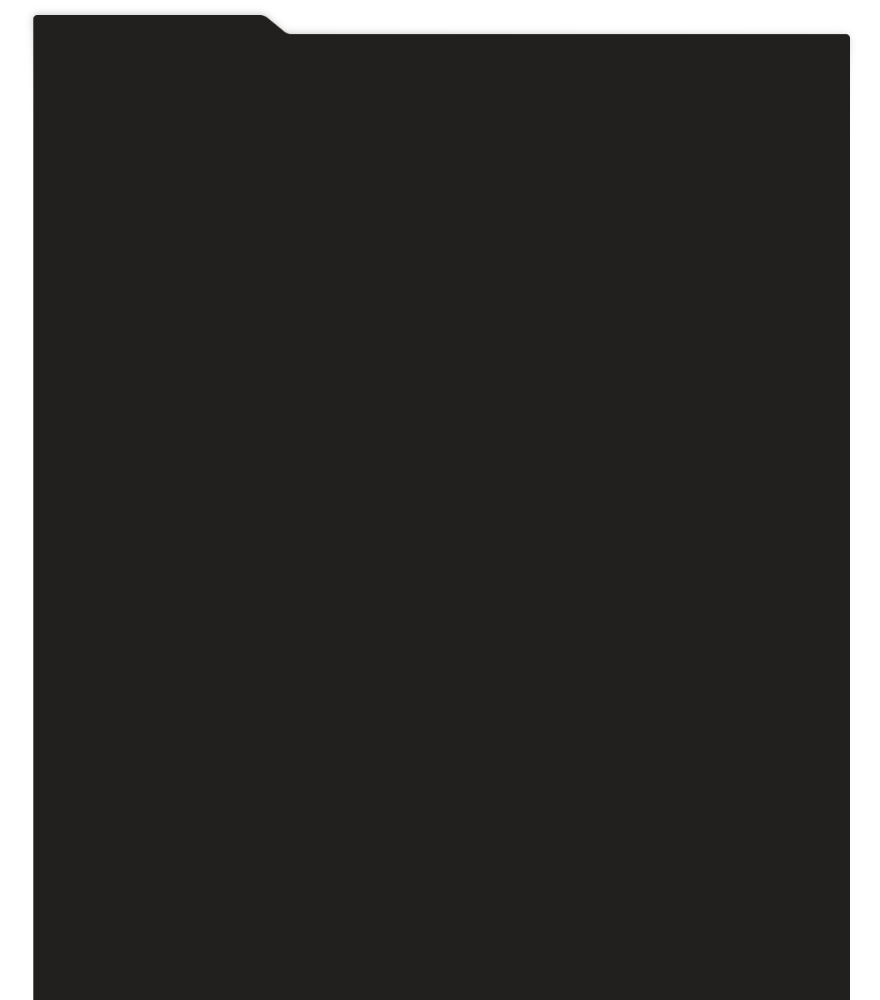
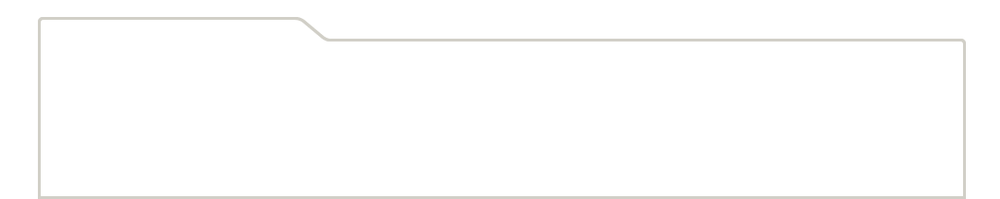
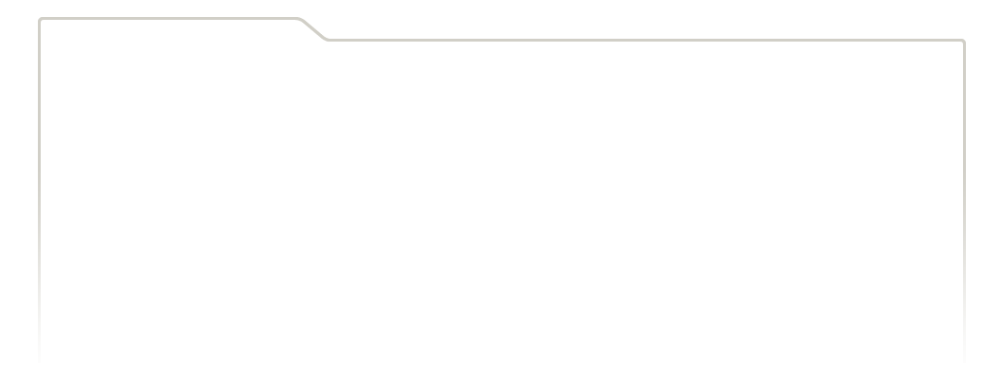
...
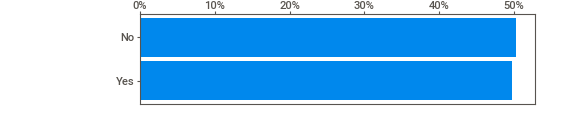
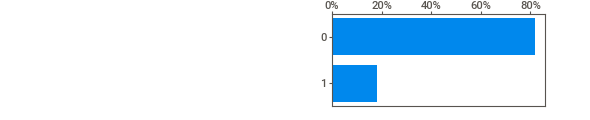
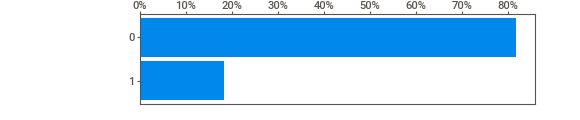
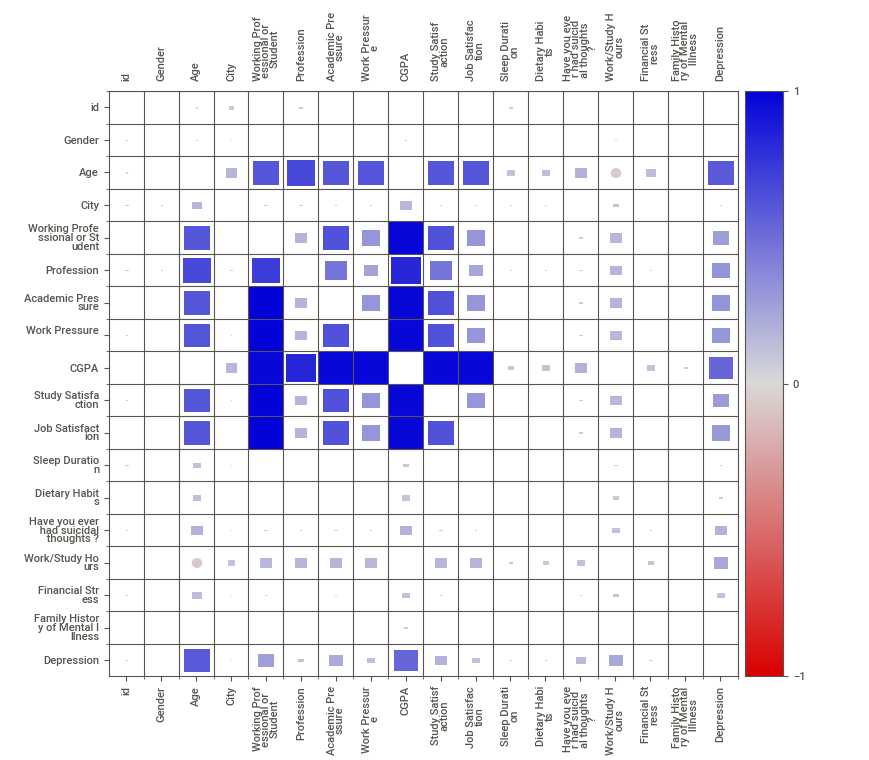
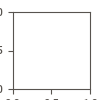

In [6]:
report = sv.analyze(train)

report.show_notebook()

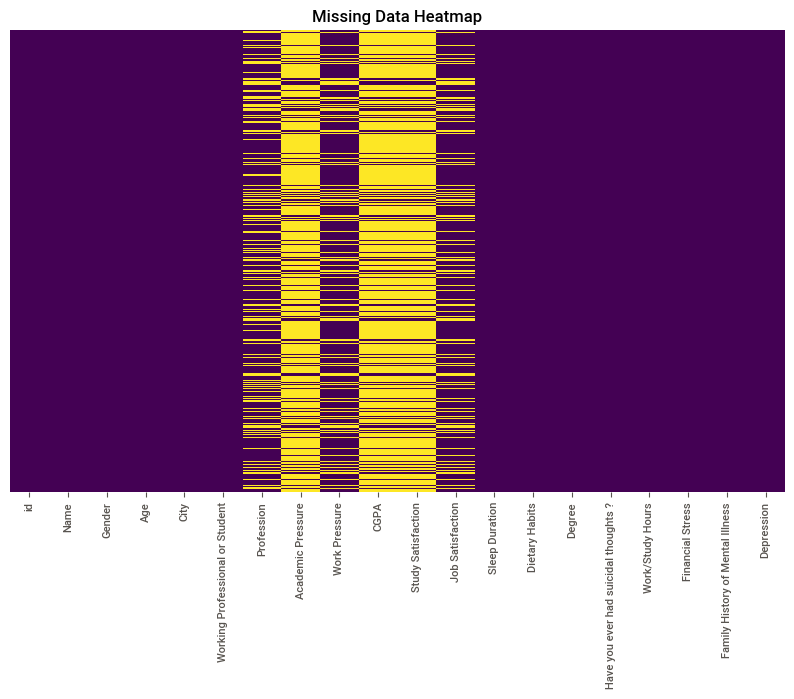

In [7]:
missing_data = train.isnull()

plt.figure(figsize=(10, 6))
sns.heatmap(missing_data, cbar=False, cmap='viridis', yticklabels=False)
plt.title('Missing Data Heatmap')
plt.show()

<a id='c3'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b>3. Data Analysis</b></div>


<a id='c2.1'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;"><b>3.1. Gender</b>
</div>

In [8]:
pv.pie_chart('Gender')

In [9]:
pv.histogram('Gender', hue=target)

<a id='c2.2'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;"><b>3.2. Age</b>
</div>

In [10]:
pv.histogram('Age', hue=target)

<a id='c2.3'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;"><b>3.3. City</b>
</div>

In [11]:
pv.histogram('City', hue=target)

<a id='c2.4'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.4. Working Professional or Student</b>
</div>

In [12]:
pv.histogram('Working Professional or Student', hue=target)

<a id='c2.5'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.5. Profession</b>
</div>

In [13]:
pv.histogram('Profession', hue=target)

<a id='c2.6'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.6. Academic Pressure</b>
</div>

In [14]:
pv.histogram('Academic Pressure', hue=target)

<a id='c2.7'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.7. Work Pressure</b>
</div>

In [15]:
pv.histogram('Work Pressure', hue=target)

<a id='c2.8'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.8. CGPA</b>
</div>

In [16]:
pv.histogram('CGPA', hue=target)

<a id='c2.9'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.9. Study Satisfaction</b>
</div>

In [17]:
pv.histogram('Study Satisfaction', hue=target)

<a id='c2.10'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.10. Job Satisfaction</b>
</div>

In [18]:
pv.histogram('Study Satisfaction', hue=target)

<a id='c2.11'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.11. Sleep Duration</b>
</div>

In [19]:
pv.histogram('Study Satisfaction', hue=target)

<a id='c2.12'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.12. Dietary Habits</b>
</div>

In [20]:
pv.histogram('Dietary Habits', hue=target)

<a id='c2.13'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.13. Degree</b>
</div>

In [21]:
pv.histogram('Degree', hue=target)

<a id='c2.14'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.14. Have you ever had suicidal thoughts?</b>
</div>

In [22]:
pv.histogram('Have you ever had suicidal thoughts ?', hue=target)

<a id='c2.15'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.15. Work/Study Hours</b>
</div>

In [23]:
pv.histogram('Work/Study Hours', hue=target)

<a id='c2.16'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.16. Financial Stress</b>
</div>

In [24]:
pv.histogram('Financial Stress', hue=target)

<a id='c2.17'></a>
<div style="text-align:center; border-radius:15px; padding:15px; color:#333333; margin:0; font-size:150%; font:'Verdana'; background: #F5F5F5; background: #E8E8E8; border: 1px solid #CCCCCC; box-shadow: 0px 4px 8px rgba(0, 0, 0, 0.2); overflow:hidden;">
    <b>3.17. Family History of Mental Illness</b>
</div>

In [25]:
pv.histogram('Family History of Mental Illness', hue=target)

<a id='c4'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b>4. Model building</b>
</div>

## DataPreprocessor Class

In [26]:
class DataPreprocessor:
    """
    A class for preprocessing data with methods to fit and transform datasets.
    Allows applying the same encoders across multiple datasets.

    Params
    ----------
    numerical_columns : list of str
    one_hot_columns : list of str
    label_columns : list of str

    Attributes
    ----------
    scaler : StandardScaler
        Scaler object for numerical features.
    one_hot_encoder : OneHotEncoder
        Encoder object for one-hot encoding.
    label_encoders : dict of OrdinalEncoder
        Dictionary of OrdinalEncoders for label encoding.

    Methods
    -------
    fit(df)
        Fits the encoders on the provided DataFrame.
    transform(df)
        Transforms the DataFrame using the fitted encoders.
    fit_transform(df)
        Fits the encoders and transforms the DataFrame.
    """

    def __init__(self, numerical_columns, one_hot_columns, label_columns):
        self.numerical_columns = numerical_columns
        self.one_hot_columns = one_hot_columns
        self.label_columns = label_columns

        self.scaler = StandardScaler()
        self.one_hot_encoder = OneHotEncoder(drop='first', sparse=False, handle_unknown='ignore')
        
        self.label_encoders = {
            col: OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1) for col in self.label_columns
        }

        self.one_hot_feature_names = None

    def fit(self, df):
        self.scaler.fit(df[self.numerical_columns])

        self.one_hot_encoder.fit(df[self.one_hot_columns])
        self.one_hot_feature_names = self.one_hot_encoder.get_feature_names_out(self.one_hot_columns)

        for col in self.label_columns:
            self.label_encoders[col].fit(df[[col]])

    def transform(self, df):
        df_scaled = df.copy()

        df_scaled[self.numerical_columns] = self.scaler.transform(df[self.numerical_columns])

        encoded_columns = self.one_hot_encoder.transform(df[self.one_hot_columns])
        encoded_df = pd.DataFrame(encoded_columns, columns=self.one_hot_feature_names, index=df.index)

        for col in self.label_columns:
            df_scaled[col] = self.label_encoders[col].transform(df[[col]])

        df_final = pd.concat([df_scaled.drop(self.one_hot_columns, axis=1), encoded_df], axis=1)

        return df_final

    def fit_transform(self, df):
        self.fit(df)
        return self.transform(df)

In [27]:
train = train.drop('id', axis=1)
train[one_hot_columns + label_columns] = train[one_hot_columns + label_columns].fillna('None')
train[numerical_columns] = train[numerical_columns].fillna(-1)

preprocessor = DataPreprocessor(numerical_columns, one_hot_columns, label_columns)

preprocessor.fit(train)

train = preprocessor.transform(train)
test = preprocessor.transform(test)

# Neural Network

In [28]:
device = torch.device('cuda')

class BinaryClassificationModel(nn.Module):
    def __init__(self, input_size):
        super(BinaryClassificationModel, self).__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.batch_norm1 = nn.BatchNorm1d(128)
        self.relu1 = nn.ReLU()
        self.dropout1 = nn.Dropout(0.1)
        
        self.fc2 = nn.Linear(128, 64)
        self.batch_norm2 = nn.BatchNorm1d(64)
        self.relu2 = nn.ReLU()
        self.dropout2 = nn.Dropout(0.1)
        
        self.fc3 = nn.Linear(64, 32)
        self.batch_norm3 = nn.BatchNorm1d(32)
        self.relu3 = nn.ReLU()
        
        self.fc4 = nn.Linear(32, 1)
        self.sigmoid = nn.Sigmoid() 

    def forward(self, x):
        out = self.fc1(x)
        out = self.batch_norm1(out)
        out = self.relu1(out)
        out = self.dropout1(out)
        
        out = self.fc2(out)
        out = self.batch_norm2(out)
        out = self.relu2(out)
        out = self.dropout2(out)
        
        out = self.fc3(out)
        out = self.batch_norm3(out)
        out = self.relu3(out)
        
        out = self.fc4(out)

        return out

In [29]:
X = train.drop(target, axis=1).apply(pd.to_numeric, errors='coerce').fillna(0).values
y = train[target].values

X = torch.tensor(X, dtype=torch.float32).to(device)
y = torch.tensor(y, dtype=torch.long).to(device)

X_test = test.drop('id', axis=1).apply(pd.to_numeric, errors='coerce').fillna(0).values
X_test_tensor = torch.tensor(X_test, dtype=torch.float32).to(device)
model = BinaryClassificationModel(input_size=X.shape[1])
model = model.to(device)

<a id='c5'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b>5. Validation</b>
</div>

## KFoldTrainer Class

In [30]:
class KFoldTrainer:
    def __init__(
        self, 
        X, 
        y, 
        model_class, 
        num_epochs=1500, 
        learning_rate=0.001, 
        k_folds=5, 
        device='cpu'
    ):
        self.X = X
        self.y = y
        self.model_class = model_class
        self.num_epochs = num_epochs
        self.learning_rate = learning_rate
        self.k_folds = k_folds
        self.device = device
        self.input_size = X.shape[1]
    
    def train(self):
        # Initialize K-Fold cross-validator
        kfold = KFold(n_splits=self.k_folds, shuffle=True)
        for fold, (train_idx, val_idx) in enumerate(kfold.split(self.X)):
            print(f'Fold {fold + 1}')
            self._train_fold(fold, train_idx, val_idx)
    
    def _train_fold(self, fold, train_idx, val_idx):
        image_filenames = []
        
        # Prepare training and validation data
        X_train = torch.tensor(self.X[train_idx], dtype=torch.float32).to(self.device)
        y_train = torch.tensor(self.y[train_idx], dtype=torch.float32).to(self.device)
        X_val = torch.tensor(self.X[val_idx], dtype=torch.float32).to(self.device)
        y_val = torch.tensor(self.y[val_idx], dtype=torch.float32).to(self.device)
        
        # Initialize the model, loss function, optimizer, and scheduler
        model = self.model_class(self.input_size).to(self.device)
        criterion = nn.BCELoss()
        optimizer = optim.Adam(model.parameters(), lr=self.learning_rate)
        scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=1000, gamma=0.1)
        
        train_losses = []
        val_accuracies = []
        
        # Training loop
        for epoch in tqdm(range(self.num_epochs), desc=f"Training Fold {fold + 1}"):
            model.train()
            optimizer.zero_grad()
            
            # Forward pass
            outputs = model(X_train).squeeze()
            outputs = torch.sigmoid(outputs)
            
            # Compute loss
            loss = criterion(outputs, y_train)
            loss.backward()
            optimizer.step()
            
            train_losses.append(loss.item())
            scheduler.step()
            
            # Validation and plotting every 50 epochs
            if (epoch + 1) % 50 == 0:
                model.eval()
                with torch.no_grad():
                    val_outputs = model(X_val).squeeze()
                    val_outputs = torch.sigmoid(val_outputs)
                    predicted = (val_outputs >= 0.5).long()
                    accuracy = accuracy_score(y_val.cpu(), predicted.cpu())
                    val_accuracies.append(accuracy)
                
                # Save plots
                filename = self._plot_and_save(train_losses, val_accuracies, fold, epoch)
                image_filenames.append(filename)
        
        # Final evaluation on validation data
        model.eval()
        with torch.no_grad():
            val_outputs = model(X_val).squeeze()
            val_outputs = torch.sigmoid(val_outputs)
            predicted = (val_outputs >= 0.5).long()
            accuracy = accuracy_score(y_val.cpu(), predicted.cpu())
            print(f'Final Accuracy on fold {fold + 1}: {accuracy:.4f}\n')
        
        # Save final plots
        final_plot_filename = self._plot_final(train_losses, val_accuracies, fold)
        image_filenames.append(final_plot_filename)
        
        # Create GIF animation
        self._create_gif(image_filenames, fold)
        
        # Remove temporary image files
        for filename in set(image_filenames):
            os.remove(filename)
    
    def _plot_and_save(self, train_losses, val_accuracies, fold, epoch):
        plt.figure(figsize=(12, 5))

        # Plot training loss
        plt.subplot(1, 2, 1)
        plt.plot(range(1, len(train_losses) + 1), train_losses, label="Training Loss")
        plt.xlabel("Epoch")
        plt.ylabel("Loss")
        plt.title("Training Loss Over Epochs")
        plt.legend()
        plt.grid(True)

        # Plot validation accuracy
        plt.subplot(1, 2, 2)
        epochs_for_accuracy = [(i+1)*50 for i in range(len(val_accuracies))]
        plt.plot(
            epochs_for_accuracy, 
            val_accuracies, 
            label="Validation Accuracy (every 50 epochs)", 
            marker='o'
        )
        plt.xlabel("Epoch")
        plt.ylabel("Accuracy")
        plt.title("Validation Accuracy Over Epochs")
        plt.legend()
        plt.grid(True)

        plt.tight_layout()
        filename = f'fold_{fold+1}_epoch_{epoch+1}.png'
        plt.savefig(filename)
        plt.close()
        return filename
    
    def _plot_final(self, train_losses, val_accuracies, fold):
        plt.figure(figsize=(12, 5))
        
        # Final training loss plot
        plt.subplot(1, 2, 1)
        plt.plot(range(1, len(train_losses) + 1), train_losses, marker='o')
        plt.title(f'Training Loss Over Epochs - Fold {fold + 1}')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.grid(True)
        
        # Final validation accuracy plot
        plt.subplot(1, 2, 2)
        epochs_for_accuracy = [(i+1)*50 for i in range(len(val_accuracies))]
        plt.plot(epochs_for_accuracy, val_accuracies, marker='o')
        plt.title(f'Validation Accuracy Over Epochs - Fold {fold + 1}')
        plt.xlabel('Epoch')
        plt.ylabel('Validation Accuracy')
        plt.grid(True)
        
        plt.tight_layout()
        final_plot_filename = f'fold_{fold+1}_final.png'
        plt.savefig(final_plot_filename)
        plt.close()
        return final_plot_filename
    
    def _create_gif(self, image_filenames, fold):
        # Create a GIF animation from the saved plots
        with imageio.get_writer(f'animation_fold_{fold+1}.gif', mode='I', duration=0.5) as writer:
            for filename in image_filenames:
                image = imageio.imread(filename)
                writer.append_data(image)

In [31]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

trainer = KFoldTrainer(
    X=X,
    y=y,
    model_class=BinaryClassificationModel,
    num_epochs=1500,
    learning_rate=0.001,
    k_folds=5,
    device=device
)

trainer.train()

Fold 1


Training Fold 1: 100%|██████████| 1500/1500 [00:30<00:00, 49.81it/s]


Final Accuracy on fold 1: 0.9352

Fold 2


Training Fold 2: 100%|██████████| 1500/1500 [00:28<00:00, 53.34it/s]


Final Accuracy on fold 2: 0.9338

Fold 3


Training Fold 3: 100%|██████████| 1500/1500 [00:28<00:00, 52.21it/s]


Final Accuracy on fold 3: 0.9353

Fold 4


Training Fold 4: 100%|██████████| 1500/1500 [00:28<00:00, 51.93it/s]


Final Accuracy on fold 4: 0.9366

Fold 5


Training Fold 5: 100%|██████████| 1500/1500 [00:28<00:00, 53.15it/s]


Final Accuracy on fold 5: 0.9338



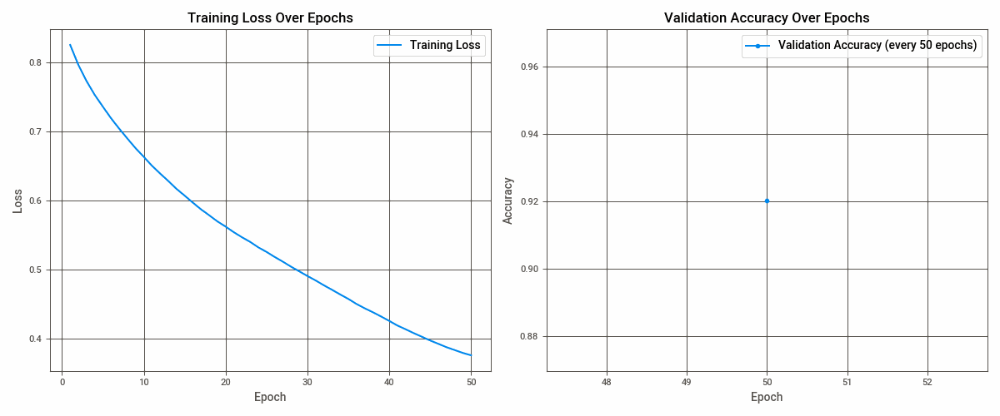

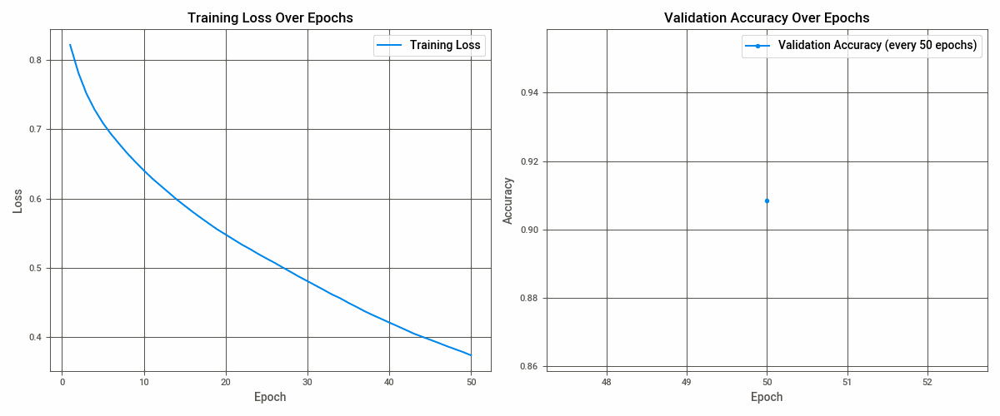

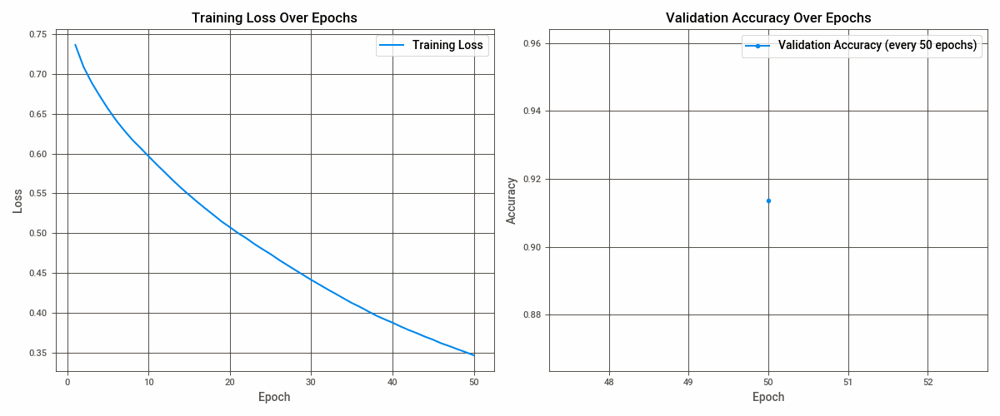

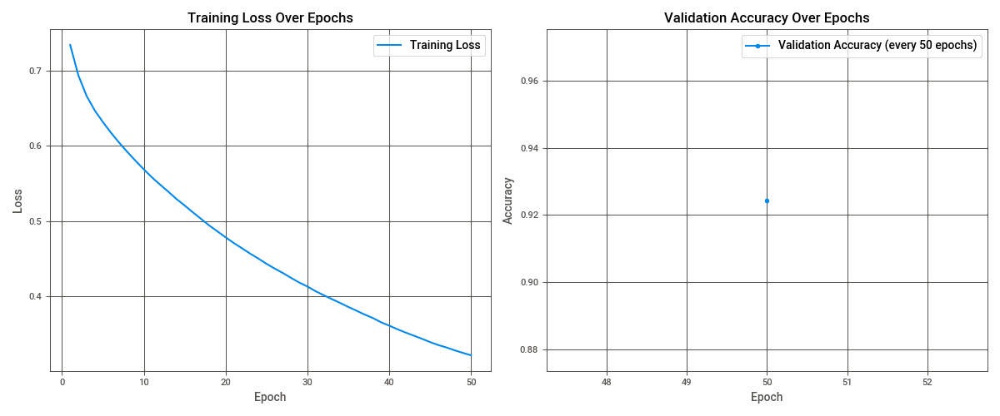

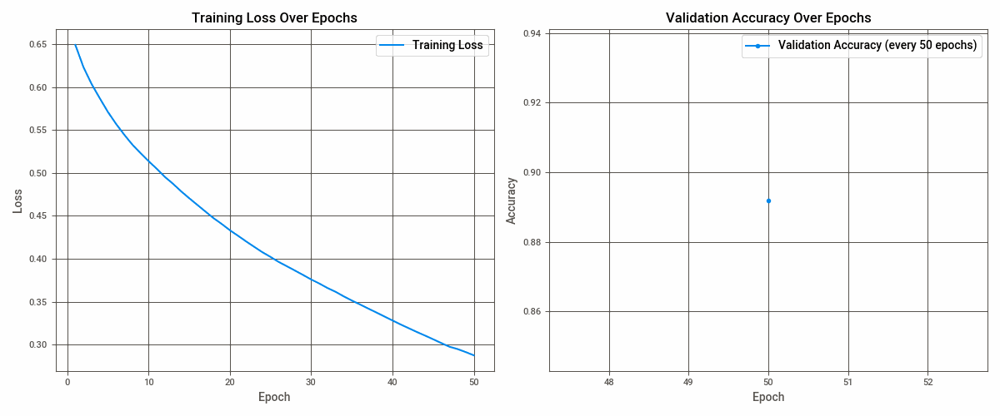

In [32]:
display(Image(filename=f'/kaggle/working/animation_fold_1.gif'))
display(Image(filename=f'/kaggle/working/animation_fold_2.gif'))
display(Image(filename=f'/kaggle/working/animation_fold_3.gif'))
display(Image(filename=f'/kaggle/working/animation_fold_4.gif'))
display(Image(filename=f'/kaggle/working/animation_fold_5.gif'))

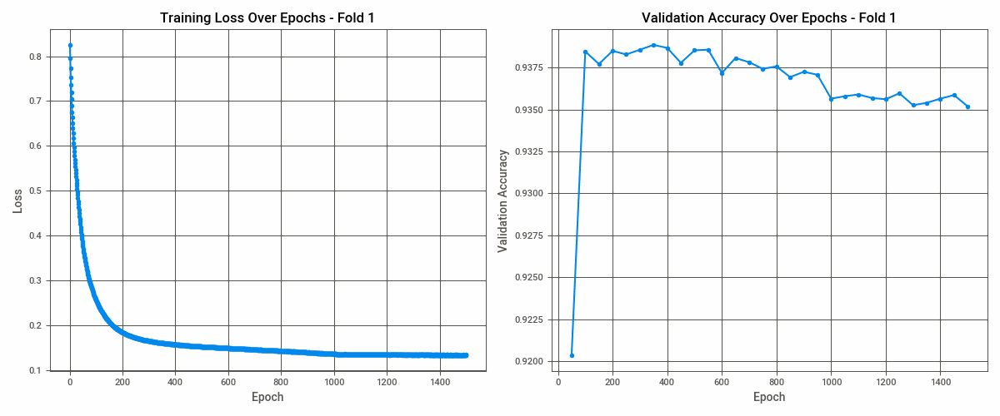

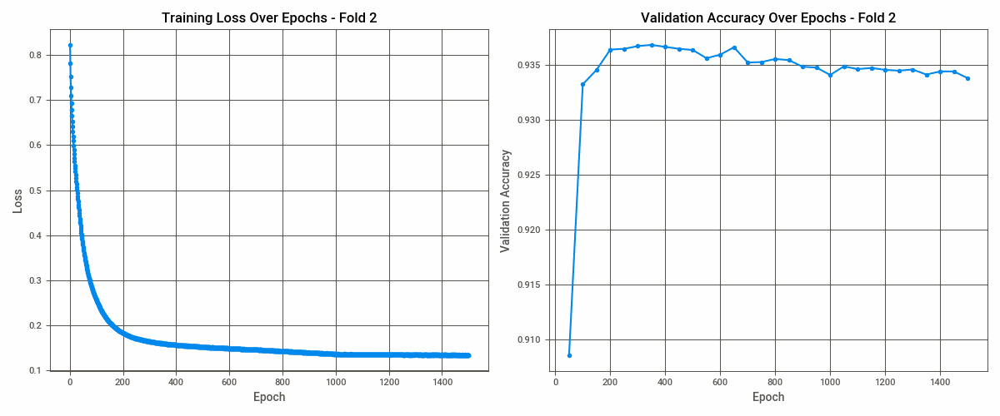

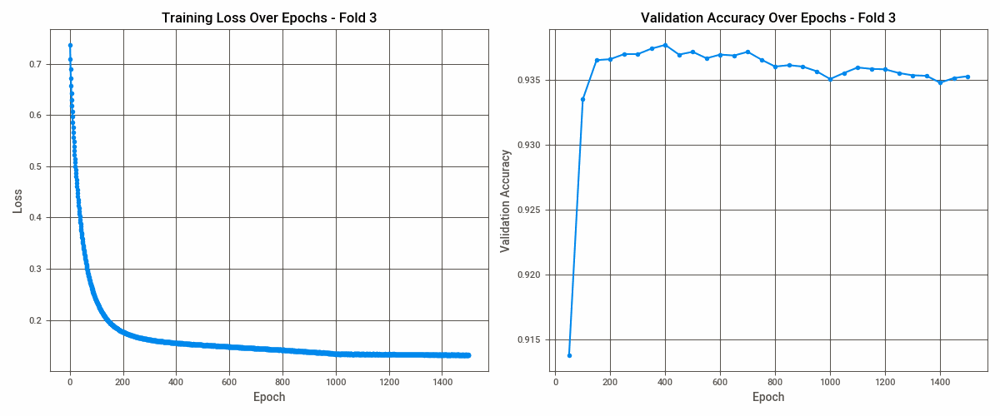

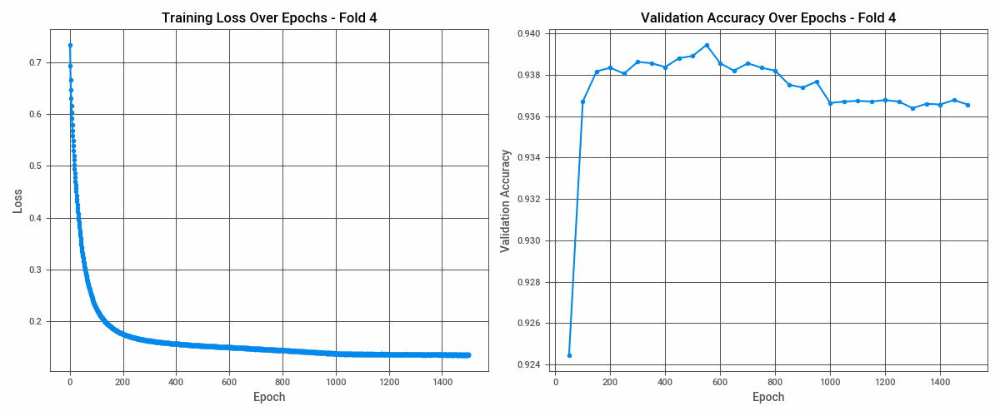

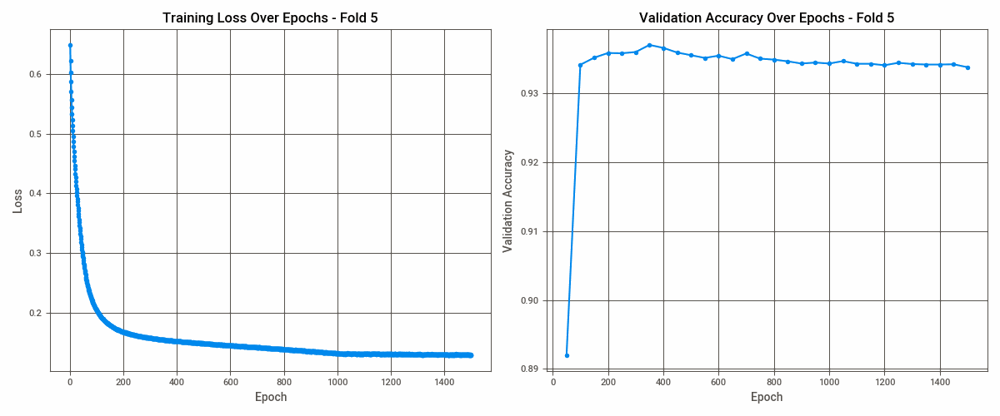

In [33]:
from PIL import Image

gif_paths = [
    '/kaggle/working/animation_fold_1.gif',
    '/kaggle/working/animation_fold_2.gif',
    '/kaggle/working/animation_fold_3.gif',
    '/kaggle/working/animation_fold_4.gif',
    '/kaggle/working/animation_fold_5.gif'
]

for gif_path in gif_paths:
    with Image.open(gif_path) as img:
        img.seek(img.n_frames - 1)
        display(img)


<a id='c6'></a>
# <div style="text-align:center; border-radius:15px 15px; padding:15px; color:#333333; margin:0; ; padding:15px; font-size:100%; font:'Verdana'; background-color:#F5F5F5;border: 1px; overflow:hidden"><b>6. Results and submission</b>
</div>

In [34]:
model.eval()
with torch.no_grad():
    y_pred = model(X_test_tensor).squeeze()
    y_pred_prob = torch.sigmoid(y_pred).cpu().numpy()
    
    y_pred_binary = (y_pred_prob >= 0.5).astype(int)

submit = pd.DataFrame({
    'id': test['id'],
    'prediction': y_pred_binary.flatten()
})

submit.to_csv("../working/submission.csv", index=False)

print(submit)

           id  prediction
0      140700           0
1      140701           1
2      140702           0
3      140703           1
4      140704           0
...       ...         ...
93795  234495           0
93796  234496           0
93797  234497           1
93798  234498           0
93799  234499           1

[93800 rows x 2 columns]
